Animation size has reached 21148020 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


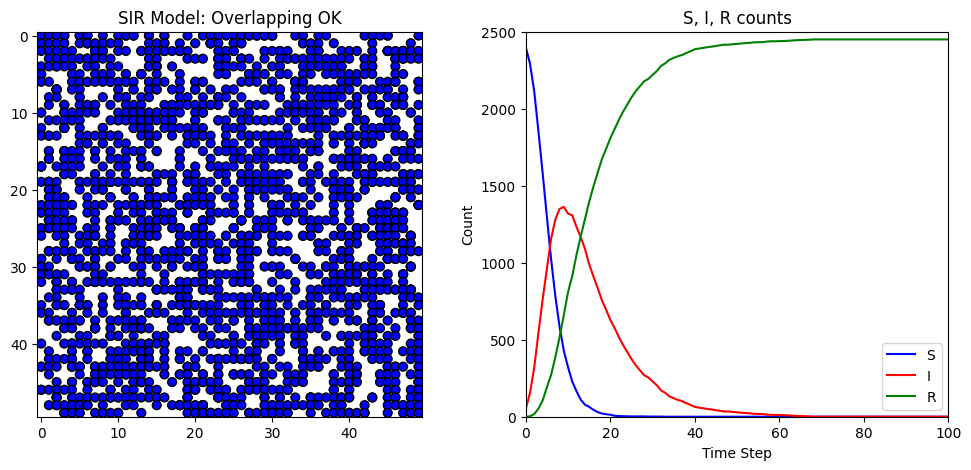

In [18]:
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# S: Susceptible, I: Infected, R: Recovered
S = 'S'
I = 'I'
R = 'R'

# 散布図で色を分けるための辞書
color_map = {
    S: 'white',
    I: 'red',
    R: 'blue'
}


def initialize_grid(n, s_count, i_count, r_count):
    """
    グリッド(n x n)を用意し、
    各セル = 空リスト [] として初期化しておく。
    
    そこに S, I, R をランダム配置する。
    """
    # 全セルをリストとして初期化
    grid = np.empty((n, n), dtype=object)
    for x in range(n):
        for y in range(n):
            grid[x, y] = []  # 各セルは空のリスト
    
    # 全セル座標リストをシャッフルし、先頭からS,I,Rを詰める
    all_positions = [(x, y) for x in range(n) for y in range(n)]
    random.shuffle(all_positions)
    
    # Sを配置
    for _ in range(s_count):
        x, y = all_positions.pop()
        grid[x, y].append(S)
    
    # Iを配置
    for _ in range(i_count):
        x, y = all_positions.pop()
        grid[x, y].append(I)
    
    # Rを配置
    for _ in range(r_count):
        x, y = all_positions.pop()
        grid[x, y].append(R)
    
    return grid


def step_sir(old_grid):
    """
    1ステップ進める:
      (A) 移動フェーズ
      (B) 感染/回復フェーズ
    old_grid[x, y] は「複数のエージェントを含むリスト」になっている。
    """
    n = old_grid.shape[0]
    
    # (A) 移動フェーズ
    # new_gridを作り、すべて空リストにしておく
    new_grid = np.empty((n, n), dtype=object)
    for xx in range(n):
        for yy in range(n):
            new_grid[xx, yy] = []
    
    # 移動対象を (x, y, 状態) のリストにまとめる
    # ランダムな順序で移動処理するためにシャッフルする
    movers = []
    for x in range(n):
        for y in range(n):
            for agent_state in old_grid[x, y]:
                movers.append((x, y, agent_state))
    random.shuffle(movers)
    
    # 移動処理 (エージェント1つずつ)
    for x, y, state in movers:
        # 8近傍からランダムに1か所を選ぶ (トーラス構造)
        dx, dy = random.choice([
            (-1, -1), (-1, 0), (-1, 1),
            (0, -1),           (0, 1),
            (1, -1),  (1, 0),  (1, 1)
        ])
        nx = (x + dx) % n
        ny = (y + dy) % n
        
        # 重複OKなので、そのまま移動先に追加
        new_grid[nx, ny].append(state)
    
    # (B) 感染/回復フェーズ
    # 感染判定や回復結果をまとめて反映させるため、一旦コピーを作成
    updated_grid = np.empty((n, n), dtype=object)
    for xx in range(n):
        for yy in range(n):
            updated_grid[xx, yy] = new_grid[xx, yy].copy()
    
    for x in range(n):
        for y in range(n):
            cell_agents = new_grid[x, y]
            
            # 1. 回復処理: I -> R (確率 RECOVERY_PROB)
            for idx, st in enumerate(cell_agents):
                if st == I:
                    if random.random() < RECOVERY_PROB:
                        updated_grid[x, y][idx] = R
            
            # 2. 感染処理: S -> I (近傍にIが1つでもいれば確率 INFECTION_PROB で感染)
            #    まず、このセルの近傍にIがいるか判定
            infected_neighbor_found = False
            
            # 近傍(含むセル自身も見るかどうかはケースに応じて選択)
            # → SIRモデルでは通常、自セル内に I がいたら当然感染する可能性がある
            #   もし自セル内の I も感染源にしたいなら range[-1,0,1] 全てチェック
            for dx in [-1, 0, 1]:
                for dy in [-1, 0, 1]:
                    nx = (x + dx) % n
                    ny = (y + dy) % n
                    if any(agent == I for agent in new_grid[nx, ny]):
                        infected_neighbor_found = True
                        break
                if infected_neighbor_found:
                    break
            
            # 感染があり得る場合、S だったものが確率で I に変化
            if infected_neighbor_found:
                for idx, st in enumerate(updated_grid[x, y]):
                    if st == S:
                        if random.random() < INFECTION_PROB:
                            updated_grid[x, y][idx] = I
    
    return updated_grid


def get_scatter_data_sir(grid):
    """
    グリッドから散布図用のリスト(x_coords, y_coords, colors)を作る。
    同じセル内に複数エージェントがいる場合、同じ座標が複数回追加される。
    """
    n = grid.shape[0]
    x_coords = []
    y_coords = []
    color_list = []
    
    for x in range(n):
        for y in range(n):
            # このセルにいるエージェントの数だけ座標を重複させる
            for st in grid[x, y]:
                x_coords.append(y)  # matplotlib の scatter では x=横軸、y=縦軸
                y_coords.append(x)
                color_list.append(color_map[st])
    
    return x_coords, y_coords, color_list


def count_SIR(grid):
    """
    グリッド全体での S, I, R の数を数える
    """
    s_count = 0
    i_count = 0
    r_count = 0
    n = grid.shape[0]
    for x in range(n):
        for y in range(n):
            for st in grid[x, y]:
                if st == S:
                    s_count += 1
                elif st == I:
                    i_count += 1
                elif st == R:
                    r_count += 1
    return s_count, i_count, r_count


def animate_sir(grid, num_steps=100, interval=200):
    """
    アニメーションを作成して返す (HTMLオブジェクト; Jupyter/Colab 向け)
      - 左: エージェント分布 (散布図)
      - 右: S, I, R の個体数推移 (折れ線グラフ)
    """
    # 全ステップの状態を格納
    grid_states = [grid.copy()]
    for _ in range(num_steps):
        nxt = step_sir(grid_states[-1])
        grid_states.append(nxt)
    
    # 各ステップでのS, I, R数
    sir_counts = [count_SIR(g) for g in grid_states]
    
    fig = plt.figure(figsize=(12, 5))
    ax1 = fig.add_subplot(1, 2, 1)
    ax2 = fig.add_subplot(1, 2, 2)
    
    # --- 左: 散布図 ---
    ax1.set_xlim(-0.5, N - 0.5)
    ax1.set_ylim(-0.5, N - 0.5)
    ax1.set_aspect('equal')
    ax1.invert_yaxis()
    ax1.set_title("SIR Model: Overlapping OK")
    
    x0, y0, c0 = get_scatter_data_sir(grid_states[0])
    scat = ax1.scatter(x0, y0, c=c0, s=40, marker='o', edgecolors='k')
    
    # --- 右: S, I, R 推移 ---
    ax2.set_xlim(0, num_steps)
    ax2.set_ylim(0, N*N)  # 最大で全セルが埋まっている場合
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Count")
    ax2.set_title("S, I, R counts")
    steps_arr = np.arange(num_steps+1)
    s_line, = ax2.plot([], [], color='blue', label='S')
    i_line, = ax2.plot([], [], color='red',  label='I')
    r_line, = ax2.plot([], [], color='green',label='R')
    ax2.legend()
    
    # アニメーションアップデート用関数
    def update(frame):
        xx, yy, cc = get_scatter_data_sir(grid_states[frame])
        scat.set_offsets(np.c_[xx, yy])
        scat.set_facecolors(cc)
        
        s_vals = [sir_counts[i][0] for i in range(frame + 1)]
        i_vals = [sir_counts[i][1] for i in range(frame + 1)]
        r_vals = [sir_counts[i][2] for i in range(frame + 1)]
        
        s_line.set_data(steps_arr[:frame+1], s_vals)
        i_line.set_data(steps_arr[:frame+1], i_vals)
        r_line.set_data(steps_arr[:frame+1], r_vals)
        
        return scat, s_line, i_line, r_line
    
    ani = animation.FuncAnimation(
        fig, update, frames=num_steps+1, interval=interval, blit=False
    )
    return HTML(ani.to_jshtml())

# ==========================
# パラメータ設定
# ==========================
N = 50  # グリッドの大きさ: 50 x 50
INITIAL_S = 2400  # 初期Susceptible数 (例)
INITIAL_I = 50    # 初期Infected数 (例)
INITIAL_R = 0     # 初期Recovered数 (例)

# 感染・回復に関する確率(例)
INFECTION_PROB = 0.3   # Sが近傍にIがいるときに感染する確率 (τ)
RECOVERY_PROB = 0.1    # IがRに回復する確率(ステップごと) (γ)

# シミュレーションステップ数
NUM_STEPS = 100

# ==========================
# メイン処理
# ==========================
# 1. グリッドの初期化

# 例として、Susceptible=2400, Infected=50, Recovered=0 で開始
grid = initialize_grid(n=N, s_count=2400, i_count=50, r_count=0)

# (2) アニメーションを生成
num_steps = 100  # シミュレーションステップ
interval = 20   # ミリ秒間隔

HTML_obj = animate_sir(grid, num_steps, interval)

# (3) 表示
HTML_obj


Animation size has reached 21207566 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


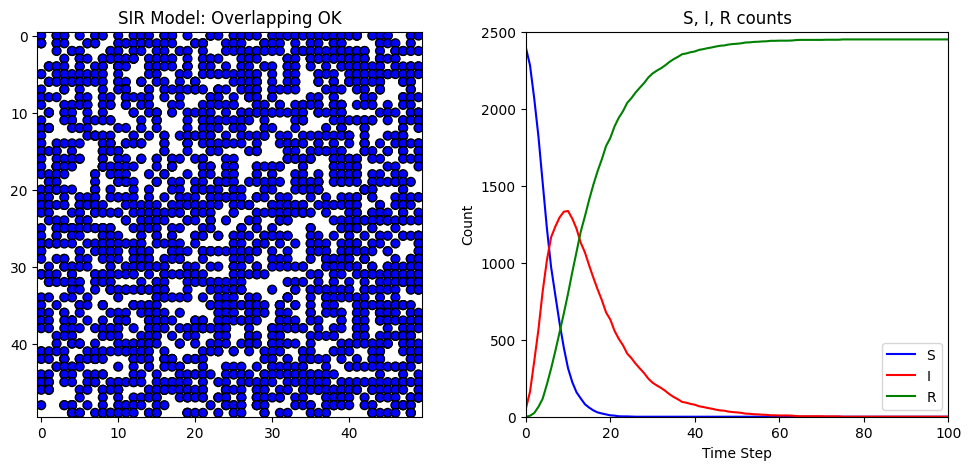

In [19]:
# ==========================
# パラメータ設定
# ==========================
N = 50  # グリッドの大きさ: 50 x 50
INITIAL_S = 2400  # 初期Susceptible数 (例)
INITIAL_I = 50    # 初期Infected数 (例)
INITIAL_R = 0     # 初期Recovered数 (例)

# 感染・回復に関する確率(例)
INFECTION_PROB = 0.3   # Sが近傍にIがいるときに感染する確率 (τ)
RECOVERY_PROB = 0.1    # IがRに回復する確率(ステップごと) (γ)

# シミュレーションステップ数
NUM_STEPS = 100

# ==========================
# メイン処理
# ==========================
# 1. グリッドの初期化

# 例として、Susceptible=2400, Infected=50, Recovered=0 で開始
grid = initialize_grid(n=N, s_count=2400, i_count=50, r_count=0)

# (2) アニメーションを生成
num_steps = 100  # シミュレーションステップ
interval = 20   # ミリ秒間隔

HTML_obj = animate_sir(grid, num_steps, interval)

# (3) 表示
HTML_obj
